#Uploading CSV Files to Colab

---



In [1]:
from google.colab import files
files.upload()

Saving sample.csv to sample.csv
Saving Tags.csv to Tags.csv
Saving Test.csv to Test.csv
Saving Train.csv to Train.csv


{'Tags.csv': b'Tags\nAnalysis of PDEs\nApplications\nArtificial Intelligence\nAstrophysics of Galaxies\nComputation and Language\nComputer Vision and Pattern Recognition\nCosmology and Nongalactic Astrophysics\nData Structures and Algorithms\nDifferential Geometry\nEarth and Planetary Astrophysics\nFluid Dynamics\nInformation Theory\nInstrumentation and Methods for Astrophysics\nMachine Learning\nMaterials Science\nMethodology\nNumber Theory\nOptimization and Control\nRepresentation Theory\nRobotics\nSocial and Information Networks\nStatistics Theory\nStrongly Correlated Electrons\nSuperconductivity\nSystems and Control\n',
 'Test.csv': b'id,ABSTRACT,Computer Science,Mathematics,Physics,Statistics\n9409,"fundamental frequency (f0) approximation from polyphonic music includes a tasks of multiple-f0, melody, vocal, and bass line estimation. historically these problems have been approached separately, and only recently, with the help of learning-based approaches. we present the multitask 

# **PROBLEM STATEMENT** (Multilevel Classification)

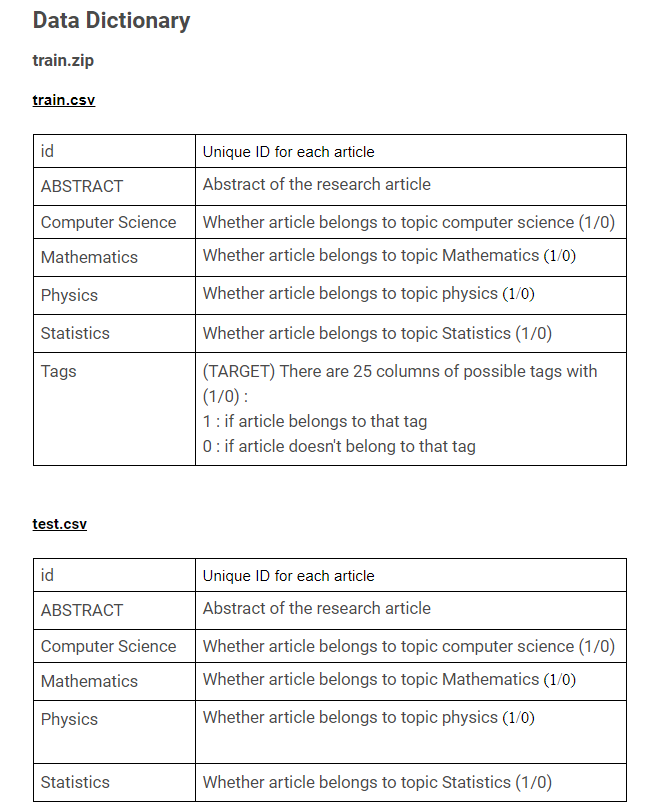

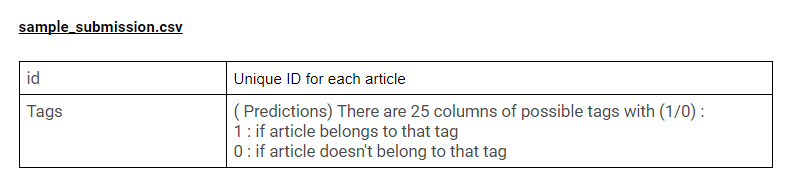

Topic Modeling for Research Articles 2.0
Researchers have access to large online archives of scientific articles. As a consequence, finding relevant articles has become more and more difficult. Tagging or topic modelling provides a way to give clear token of identification to research articles which facilitates recommendation and search process. 

Earlier on the Independence Day we conducted a Hackathon to predict the topics for each article included in the test set. Continuing with the same problem, In this Live Hackathon we will take one more step ahead and predict the tags associated with the articles.

Given the abstracts for a set of research articles, predict the tags for each article included in the test set. 
Note that a research article can possibly have multiple tags. The research article abstracts are sourced from the following 4 topics: 

1. Computer Science

2. Mathematics

3. Physics

4. Statistics

List of possible tags are as follows:

[Tags, Analysis of PDEs, Applications, Artificial Intelligence,Astrophysics of Galaxies, Computation and Language, Computer Vision and Pattern Recognition, Cosmology and Nongalactic Astrophysics, Data Structures and Algorithms, Differential Geometry, Earth and Planetary Astrophysics, Fluid Dynamics,Information Theory, Instrumentation and Methods for Astrophysics, Machine Learning, Materials Science, Methodology, Number Theory, Optimization and Control, Representation Theory, Robotics, Social and Information Networks, Statistics Theory, Strongly Correlated Electrons, Superconductivity, Systems and Control]

# Importing Libraries

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
plt.style.use('seaborn-whitegrid')

import seaborn as sns
from sklearn.model_selection import train_test_split, StratifiedKFold
from sklearn.metrics import accuracy_score, f1_score
from sklearn.model_selection import KFold, train_test_split

from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import GaussianNB

from lightgbm import LGBMRegressor

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

import warnings
warnings.simplefilter('ignore')

#Importing data

In [3]:
train = pd.read_csv('Train.csv')
test = pd.read_csv('Test.csv')
ss = pd.read_csv('sample.csv')
tags = pd.read_csv('Tags.csv')

In [4]:
train.head(3)
test.head(3)
tags.head(3)

train.shape

,id,ABSTRACT,Computer Science,Mathematics,Physics,Statistics,Analysis of PDEs,Applications,Artificial Intelligence,Astrophysics of Galaxies,Computation and Language,Computer Vision and Pattern Recognition,Cosmology and Nongalactic Astrophysics,Data Structures and Algorithms,Differential Geometry,Earth and Planetary Astrophysics,Fluid Dynamics,Information Theory,Instrumentation and Methods for Astrophysics,Machine Learning,Materials Science,Methodology,Number Theory,Optimization and Control,Representation Theory,Robotics,Social and Information Networks,Statistics Theory,Strongly Correlated Electrons,Superconductivity,Systems and Control
0,1824,a ever-growing datasets inside observational a...,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0
1,3094,we propose the framework considering optimal $...,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,8463,nanostructures with open shell transition meta...,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0


,id,ABSTRACT,Computer Science,Mathematics,Physics,Statistics
0,9409,fundamental frequency (f0) approximation from ...,0,0,0,1
1,17934,"this large-scale study, consisting of 24.5 mil...",1,0,0,1
2,16071,we present a stability analysis of the plane c...,0,0,1,0


,Tags
0,Analysis of PDEs
1,Applications
2,Artificial Intelligence


(14004, 31)

In [5]:
tags

,Tags
0,Analysis of PDEs
1,Applications
2,Artificial Intelligence
3,Astrophysics of Galaxies
4,Computation and Language
5,Computer Vision and Pattern Recognition
6,Cosmology and Nongalactic Astrophysics
7,Data Structures and Algorithms
8,Differential Geometry
9,Earth and Planetary Astrophysics


In [7]:
ID_COL = 'id'

TARGET_COLS = ['Analysis of PDEs', 'Applications',                                                   #Multiple Target
               'Artificial Intelligence', 'Astrophysics of Galaxies',
               'Computation and Language', 'Computer Vision and Pattern Recognition',
               'Cosmology and Nongalactic Astrophysics',
               'Data Structures and Algorithms', 'Differential Geometry',
               'Earth and Planetary Astrophysics', 'Fluid Dynamics',
               'Information Theory', 'Instrumentation and Methods for Astrophysics',
               'Machine Learning', 'Materials Science', 'Methodology', 'Number Theory',
               'Optimization and Control', 'Representation Theory', 'Robotics',
               'Social and Information Networks', 'Statistics Theory',
               'Strongly Correlated Electrons', 'Superconductivity',
               'Systems and Control']

TOPIC_COLS = ['Computer Science', 'Mathematics', 'Physics', 'Statistics']

### 2. **Dataset Shape (Number of Samples and Variables in the dataset)**

In [8]:
print(f'\n->->->| Train contains {train.shape[0]} samples and {train.shape[1]} variables')
print(f'\n->->->| Test contains {test.shape[0]} samples and {test.shape[1]} variables')
print(f'\n->->->| Number of distinct SUB TOPICS is {len(TARGET_COLS)}')

features = [c for c in train.columns if c not in [ID_COL] + TARGET_COLS]
print(f'\n->->->| The dataset contains {len(features)} features')


->->->| Train contains 14004 samples and 31 variables

->->->| Test contains 6002 samples and 6 variables

->->->| Number of distinct SUB TOPICS is 25

->->->| The dataset contains 5 features


### **3.Target Distribution**

In [9]:
100 * (train[TARGET_COLS].sum()/(train.shape[0])).sort_values(ascending=False)

Machine Learning                                27.313625
Artificial Intelligence                          9.825764
Robotics                                         6.812339
Computer Vision and Pattern Recognition          6.705227
Strongly Correlated Electrons                    6.376750
Materials Science                                5.534133
Computation and Language                         4.605827
Cosmology and Nongalactic Astrophysics           4.520137
Optimization and Control                         4.434447
Social and Information Networks                  4.420166
Analysis of PDEs                                 4.334476
Applications                                     4.227364
Astrophysics of Galaxies                         4.098829
Methodology                                      4.098829
Systems and Control                              4.041702
Differential Geometry                            3.963153
Superconductivity                                3.870323
Statistics The

###**4. Variable Datatypes**

Lets have a look at the kind of data types that is being used to store the variables in pandas.

pandas info() method on dataframe allows to do that. For each variable we can see the number of non-null values along with their datatypes.



In [10]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14004 entries, 0 to 14003
Data columns (total 31 columns):
 #   Column                                        Non-Null Count  Dtype 
---  ------                                        --------------  ----- 
 0   id                                            14004 non-null  int64 
 1   ABSTRACT                                      14004 non-null  object
 2   Computer Science                              14004 non-null  int64 
 3   Mathematics                                   14004 non-null  int64 
 4   Physics                                       14004 non-null  int64 
 5   Statistics                                    14004 non-null  int64 
 6   Analysis of PDEs                              14004 non-null  int64 
 7   Applications                                  14004 non-null  int64 
 8   Artificial Intelligence                       14004 non-null  int64 
 9   Astrophysics of Galaxies                      14004 non-null  int64 
 10

### **5. Null Values**

In [11]:
null_values_per_variable = 100 * (train.isnull().sum()/train.shape[0]).round(3)#.reset_index()
null_values_per_variable.sort_values(ascending=False)

Systems and Control                             0.0
Differential Geometry                           0.0
ABSTRACT                                        0.0
Computer Science                                0.0
Mathematics                                     0.0
Physics                                         0.0
Statistics                                      0.0
Analysis of PDEs                                0.0
Applications                                    0.0
Artificial Intelligence                         0.0
Astrophysics of Galaxies                        0.0
Computation and Language                        0.0
Computer Vision and Pattern Recognition         0.0
Cosmology and Nongalactic Astrophysics          0.0
Data Structures and Algorithms                  0.0
Earth and Planetary Astrophysics                0.0
Superconductivity                               0.0
Fluid Dynamics                                  0.0
Information Theory                              0.0
Instrumentat

### **6. Unique values in each variable**

In [12]:
train.nunique()

id                                              14004
ABSTRACT                                        14004
Computer Science                                    2
Mathematics                                         2
Physics                                             2
Statistics                                          2
Analysis of PDEs                                    2
Applications                                        2
Artificial Intelligence                             2
Astrophysics of Galaxies                            2
Computation and Language                            2
Computer Vision and Pattern Recognition             2
Cosmology and Nongalactic Astrophysics              2
Data Structures and Algorithms                      2
Differential Geometry                               2
Earth and Planetary Astrophysics                    2
Fluid Dynamics                                      2
Information Theory                                  2
Instrumentation and Methods 

**ADDITIONAL DESCRIPTIVE EDA**

In [14]:
train[TOPIC_COLS].sum().sort_values(ascending=False)

Computer Science    5884
Physics             3856
Statistics          3794
Mathematics         2831
dtype: int64

## **VISUAL EDA THROUGH WORDCLOUDS**

In [15]:
from wordcloud import WordCloud, STOPWORDS
wc = WordCloud(stopwords = set(list(STOPWORDS) + ['inside']), random_state = 42)

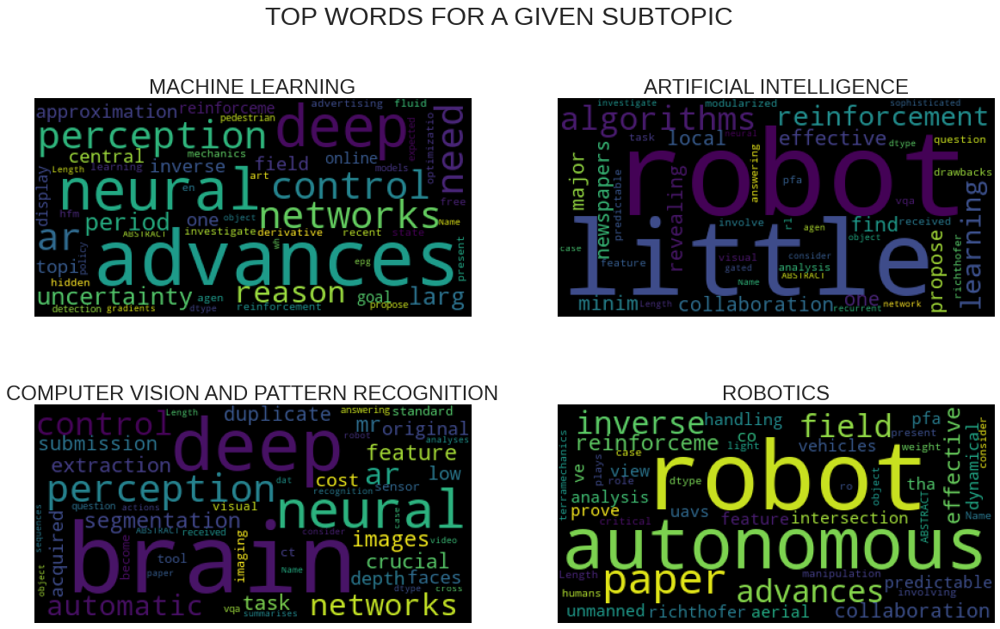

In [16]:
fig, axes = plt.subplots(2, 2, figsize=(20, 12))
axes = [ax for axes_row in axes for ax in axes_row]
for i, sub_topic_name in enumerate(['Machine Learning', 'Artificial Intelligence', 'Computer Vision and Pattern Recognition', 'Robotics']):
  sub_topic = train[train[sub_topic_name] == 1]
  op = wc.generate(str(sub_topic['ABSTRACT']))
  _ = axes[i].imshow(op)
  _ = axes[i].set_title(sub_topic_name.upper(), fontsize=24)
  _ = axes[i].axis('off')
_ = plt.suptitle('TOP WORDS FOR A GIVEN SUBTOPIC', fontsize=30)

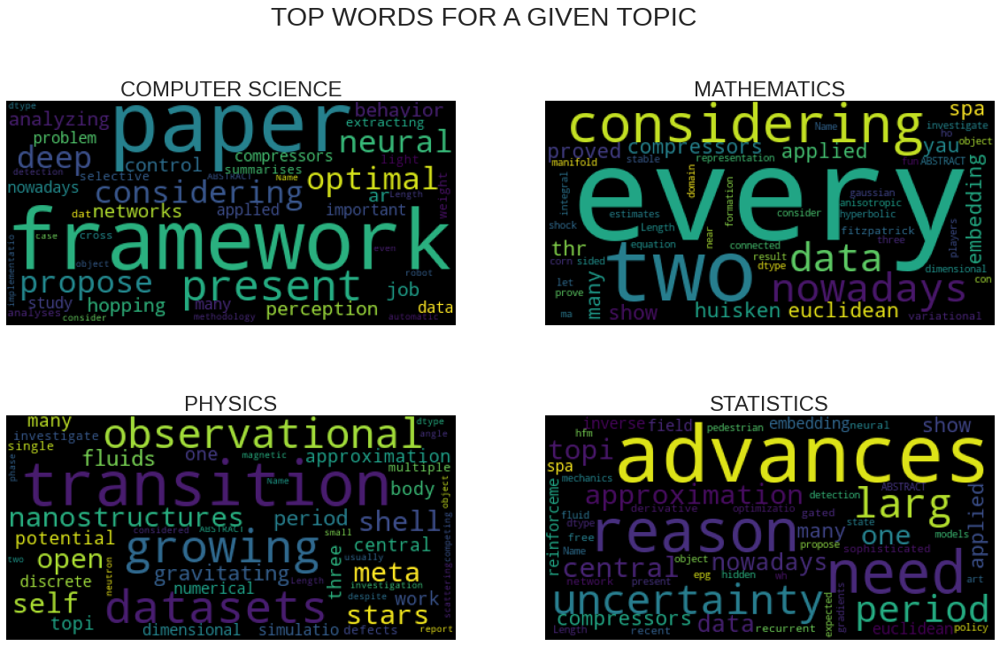

In [17]:
fig, axes = plt.subplots(2, 2, figsize=(20, 12))
axes = [ax for axes_row in axes for ax in axes_row]
for i, sub_topic_name in enumerate(TOPIC_COLS):
  sub_topic = train[train[sub_topic_name] == 1]
  op = wc.generate(str(sub_topic['ABSTRACT']))
  _ = axes[i].imshow(op)
  _ = axes[i].set_title(sub_topic_name.upper(), fontsize=24)
  _ = axes[i].axis('off')
_ = plt.suptitle('TOP WORDS FOR A GIVEN TOPIC', fontsize=30)

# **MODEL BUILDING**

## **Bag of Words Approach**

* **Text**: Collection of Words
* **Word**: Adds some kind of meaning to the sentence.
* We make a bag containing all the words in our dataset.
* **Features** : How many times is a particular word from the bag is present in our sentence ?

### **Count Vectorizer**

In [22]:
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer                    #importing Count Vector and TF-IDF

In [23]:
vec = CountVectorizer(max_features=10000)                                                       #Initializing Count Vector
combined = list(train['ABSTRACT']) + list(test['ABSTRACT'])                                     #Combining train and test abstract
vec.fit(combined)                                                                               #fitting vector

CountVectorizer(analyzer='word', binary=False, decode_error='strict',
                dtype=<class 'numpy.int64'>, encoding='utf-8', input='content',
                lowercase=True, max_df=1.0, max_features=10000, min_df=1,
                ngram_range=(1, 1), preprocessor=None, stop_words=None,
                strip_accents=None, token_pattern='(?u)\\b\\w\\w+\\b',
                tokenizer=None, vocabulary=None)

In [28]:
trn, val = train_test_split(train, test_size=0.2, random_state=2)                               #Splitting into train and validation sets

In [29]:
trn_abs = vec.transform(trn['ABSTRACT'])
val_abs = vec.transform(val['ABSTRACT'])
tst_abs = vec.transform(test['ABSTRACT'])

In [31]:
%%time                                                                                          #timer

from sklearn.multiclass import OneVsRestClassifier                                                   
clf = OneVsRestClassifier(LogisticRegression(C = 10, n_jobs=-1))                                #model classifier
clf.fit(trn_abs, trn[TARGET_COLS])                                                              #fitting model

CPU times: user 366 ms, sys: 159 ms, total: 525 ms
Wall time: 17.5 s


In [32]:
val_preds = clf.predict(val_abs)                                                              #predicting model                  
f1_score(val[TARGET_COLS], val_preds, average='micro')                                        #evaluating validation model (F1 score metric)

0.623196768609348

## **Tfidf Vectorizer**

In [34]:
vec = TfidfVectorizer(max_features=10000)                                 #Initializing TF-IDF Vector
_ = vec.fit(list(train['ABSTRACT']) + list(test['ABSTRACT']))             #combining and fitting train and test vector

trn_abs = vec.transform(trn['ABSTRACT'])                                  
val_abs = vec.transform(val['ABSTRACT'])
tst_abs = vec.transform(test['ABSTRACT'])

clf = OneVsRestClassifier(LogisticRegression(C = 10, n_jobs=-1))
_ = clf.fit(trn_abs, trn[TARGET_COLS])                                   #fitting model

val_preds = clf.predict(val_abs)                                         #predicting validation model
f1_score(val[TARGET_COLS], val_preds, average='micro')                   #evaluating validation model

0.6300845429893125

### **Optimal Threshold for F1-score**

In [35]:
def get_best_thresholds(true, preds):
  thresholds = [i/100 for i in range(100)]
  best_thresholds = []
  for idx in range(25):
    f1_scores = [f1_score(true[:, idx], (preds[:, idx] > thresh) * 1) for thresh in thresholds]
    best_thresh = thresholds[np.argmax(f1_scores)]
    best_thresholds.append(best_thresh)
  return best_thresholds

In [36]:
val_preds = clf.predict_proba(val_abs)                                                     #predicted values

best_thresholds = get_best_thresholds(val[TARGET_COLS].values, val_preds)                  #passing true values and predicted values 

for i, thresh in enumerate(best_thresholds):                                               #optimizing to best threshold
  val_preds[:, i] = (val_preds[:, i] > thresh) * 1
  
f1_score(val[TARGET_COLS], val_preds, average='micro')                                     #evaluating at best best threshold

0.6872952311612669

**Combining Topics** Feature Engineering

In [37]:
trn_abs.shape

(11203, 10000)

In [39]:
vec = CountVectorizer(max_features=10000)
_ = vec.fit(list(train['ABSTRACT']) + list(test['ABSTRACT']))

trn_abs = vec.transform(trn['ABSTRACT'])
val_abs = vec.transform(val['ABSTRACT'])
tst_abs = vec.transform(test['ABSTRACT'])
print(trn_abs.shape, val_abs.shape, tst_abs.shape)

(11203, 10000) (2801, 10000) (6002, 10000)


In [40]:
#combining 'topics' 
trn2 = np.hstack((trn_abs.toarray(), trn[TOPIC_COLS]))
val2 = np.hstack((val_abs.toarray(), val[TOPIC_COLS]))
tst2 = np.hstack((tst_abs.toarray(), test[TOPIC_COLS]))

print(trn2.shape, val2.shape, tst2.shape)

(11203, 10004) (2801, 10004) (6002, 10004)


In [41]:
from scipy.sparse import csr_matrix

trn2 = csr_matrix(trn2.astype('int16'))
val2 = csr_matrix(val2.astype('int16'))
tst2 = csr_matrix(tst2.astype('int16'))

In [42]:
clf = OneVsRestClassifier(LogisticRegression(C = 10, n_jobs=-1))                           
_  = clf.fit(trn2, trn[TARGET_COLS])                                          #Fitting model

val_preds = clf.predict_proba(val2)
best_thresholds = get_best_thresholds(val[TARGET_COLS].values, val_preds)

for i, thresh in enumerate(best_thresholds):                                  #optimizing to best threshold
  val_preds[:, i] = (val_preds[:, i] > thresh) * 1

f1_score(val[TARGET_COLS], val_preds, average='micro')                        #Evaluating at best threshold

0.7119645494830134

**What more can you do ?**

* Hyperparameter tuning (Refer earlier Hacklive Sessions).
* n-gram models instead of 1 gram models. Try 2-gram models, 3-gram models.
* Text Cleaning.


## **Word Embeddings**

* Problems with BOW approach.


In [46]:
#Padding is required as keras expects sentences to be of equal length

train['text'] = ' '
test['text'] = ' '


train['text'] += train['ABSTRACT']
test['text'] += test['ABSTRACT']

trn, val = train_test_split(train, test_size=0.2, random_state=2)

In [47]:
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences

tok = Tokenizer(num_words = 1000000)
tok.fit_on_texts(train['text'].str.lower().tolist() + test['text'].str.lower().tolist())

vocab_size = len(tok.word_index) + 1

In [48]:
X_trn = tok.texts_to_sequences(trn['text'])
X_val = tok.texts_to_sequences(val['text'])
X_test = tok.texts_to_sequences(test['text'])

In [49]:
maxlen = 200
X_trn = pad_sequences(X_trn, maxlen=maxlen)
X_val = pad_sequences(X_val, maxlen=maxlen)
X_test = pad_sequences(X_test, maxlen=maxlen)

In [50]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Embedding, Flatten, Dense, Dropout, SpatialDropout1D, LSTM


embedding_dim = 50
vocab_size = len(tok.word_index) + 1

model = Sequential()
model.add(Embedding(input_dim=vocab_size,
                    output_dim=embedding_dim,
                    input_length=maxlen))

model.add(Flatten())
model.add(Dense(200, activation='relu', name = 'Fully_Connected'))
model.add(Dense(25, activation='sigmoid', name = 'Output'))
model.compile(optimizer=tf.keras.optimizers.Adam(lr = 1e-3),
              loss='binary_crossentropy',
              metrics=['accuracy'],
              )

model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (None, 200, 50)           2583250   
_________________________________________________________________
flatten (Flatten)            (None, 10000)             0         
_________________________________________________________________
Fully_Connected (Dense)      (None, 200)               2000200   
_________________________________________________________________
Output (Dense)               (None, 25)                5025      
Total params: 4,588,475
Trainable params: 4,588,475
Non-trainable params: 0
_________________________________________________________________


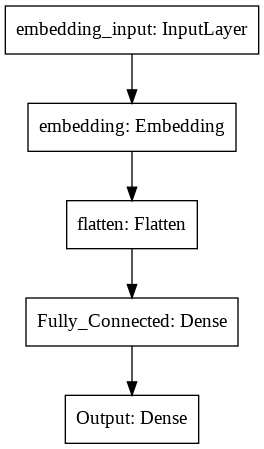

In [51]:
tf.keras.utils.plot_model(model)

In [52]:
model.fit(X_trn, trn[TARGET_COLS], validation_data=(X_val, val[TARGET_COLS]), verbose=True, epochs=20, batch_size=256,
          callbacks = [tf.keras.callbacks.ReduceLROnPlateau()])

Epoch 1/20
44/44 [==============================] - 2s 36ms/step - loss: 0.2855 - accuracy: 0.1556 - val_loss: 0.1927 - val_accuracy: 0.1653
Epoch 2/20
44/44 [==============================] - 1s 33ms/step - loss: 0.1802 - accuracy: 0.2019 - val_loss: 0.1699 - val_accuracy: 0.2456
Epoch 3/20
44/44 [==============================] - 1s 32ms/step - loss: 0.1497 - accuracy: 0.3173 - val_loss: 0.1509 - val_accuracy: 0.3006
Epoch 4/20
44/44 [==============================] - 1s 32ms/step - loss: 0.1244 - accuracy: 0.4465 - val_loss: 0.1368 - val_accuracy: 0.3484
Epoch 5/20
44/44 [==============================] - 1s 32ms/step - loss: 0.0957 - accuracy: 0.6251 - val_loss: 0.1247 - val_accuracy: 0.4231
Epoch 6/20
44/44 [==============================] - 1s 32ms/step - loss: 0.0662 - accuracy: 0.7452 - val_loss: 0.1164 - val_accuracy: 0.4980
Epoch 7/20
44/44 [==============================] - 1s 32ms/step - loss: 0.0423 - accuracy: 0.7926 - val_loss: 0.1163 - val_accuracy: 0.5159
Epoch 8/20
44

In [53]:
def get_best_thresholds(true, preds):
  thresholds = [i/100 for i in range(100)]
  best_thresholds = []
  for idx in range(25):
    f1_scores = [f1_score(true[:, idx], (preds[:, idx] > thresh) * 1) for thresh in thresholds]
    best_thresh = thresholds[np.argmax(f1_scores)]
    best_thresholds.append(best_thresh)
  return best_thresholds

val_preds = model.predict(X_val)
best_thresholds = get_best_thresholds(val[TARGET_COLS].values, val_preds)
for i, thresh in enumerate(best_thresholds):
  val_preds[:, i] = (val_preds[:, i] > thresh) * 1
f1_score(val[TARGET_COLS], val_preds, average='micro')

0.5851851851851851